# Algotytm przecinania się odcinków na płaszczyźnie

In [1]:
# !pip install sortedcontainers
# !pip install SortedSet

In [1]:
import numpy as np
import pandas as pd
from bitalg.tests.test4 import Test
from bitalg.visualizer.main import Visualizer
import SortedSet
import sortedcontainers as sc
import matplotlib.pyplot as plt
from queue import PriorityQueue

# Przydatne funkcje 

In [2]:
def draw_example_1():
    # TODO narysowac to uzywając naszego narzędzia do wizualizacji
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))

    vis.add_line_segment(line_segments)
    vis.show()
    
def draw_example_2():
    # TODO narysowac to uzywając naszego narzędzia do wizualizacji
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))
    points = [(4, 2),
              (2.5, 3.5),
              (5.5, 4.5)]

    vis.add_line_segment(line_segments)
    vis.add_point(points, color='red')
    vis.show()


### Wprowadzenie
Celem ćwiczenia jest implementacja i zapoznanie się z algorytmem wyznaczającym wszystkie przecięcia się odcinków na płaszczyźnie

### Przykładowy zbiór odcinków przed wyznaczeniem punktów przecięcia

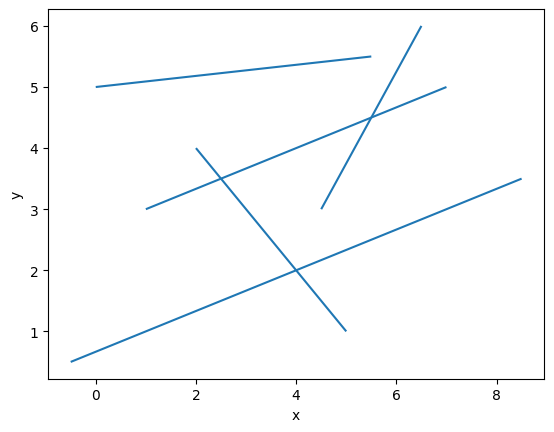

In [3]:
draw_example_1()

### Przykładowy zbiór odcinków po wyznaczenu punktów przecięcia

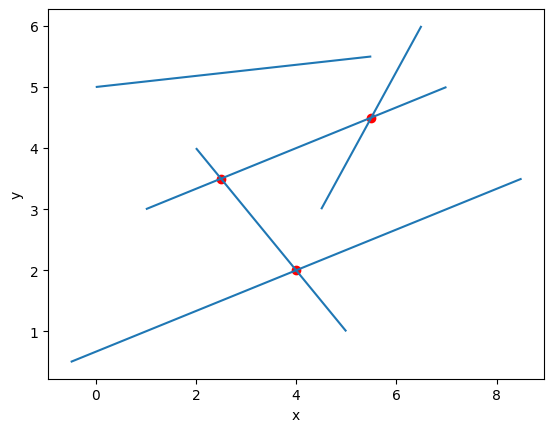

In [4]:
draw_example_2()

# Generowanie losowych odcinków na płaszczyźnie

Uzupełnij funkcję ```generate_uniform_sections```

In [5]:
def generate_uniform_sections(max_x, max_y, n):
    """
    Funkcja generuje odcinki o współrzędnych rzeczywistych w postaci par punktów. 
    Żaden wygenerowany odcinek nie jest odcinkiem pionowym.
    Żadne dwa odcinki nie mają swoich końców o takiej samej współrzędnej x.
    Zakres współrzędnych: x -> (0, max_x), y -> (0, max_y)
    :param max_x: określa maksymalną wartość współrzednej x jaka może zostać wylosowana
    :param max_y: określa maksymalną wartość współrzednej y jaka może zostać wylosowana
    :param n: ilość generowanych odcinków
    :return: tablica odcinków w postaci krotek zawierających parę krotek współrzędnych punktów końcowych odcinków
    np. [((x1, y1), (x2, y2)), ((x3, y3), (x4, y4)),...]
    """
    sections = []
    x_values = set()

    for _ in range(n):
        x1 = np.random.uniform(0, max_x)
        x2 = np.random.uniform(0, max_x)

        while x1 == x2 or x1 in x_values or x2 in x_values:
            x1 = np.random.uniform(0, max_x)
            x2 = np.random.uniform(0, max_x)

        x_values.add(x1)
        x_values.add(x2)

        y1 = np.random.uniform(0, max_y)
        y2 = np.random.uniform(0, max_y)

        section = ((x1, y1), (x2, y2))
        sections.append(section)

    # print(sections)

    return sections
    # raise Exception("Unimplemented")

generate_uniform_sections(10, 10, 5)

[((4.511097179649315, 8.264050856367769),
  (0.2416399012825332, 7.095560477275711)),
 ((4.37381841962279, 8.864645346073752),
  (9.564009404153248, 4.295815885585849)),
 ((6.759059240067945, 7.830035977780657),
  (7.7701317403329275, 7.631601431097205)),
 ((1.4008552467680957, 5.82693425940135),
  (3.752553065127633, 2.353372272974652)),
 ((9.407153379226497, 4.710763851650928),
  (0.44249886458639476, 4.4038096506038205))]

In [6]:
Test().runtest(1, generate_uniform_sections)

Lab 4, task 1:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.235s


<span style="color:red">Ćw.</span> Wygeneruj $\large20$ losowych odcinków w przestrzeni 2D o współrzędnych z przedziału $\large x \in \langle 0,1000 \rangle$ oraz $\large y \in \langle 0,1000\rangle$. 

In [7]:
section = generate_uniform_sections(1000, 1000, 20)

Zwizualizuj otrzymane odcinki

In [8]:
def vis_sections(sections):
    vis = Visualizer()
    vis.add_line_segment(sections)
    vis.show()


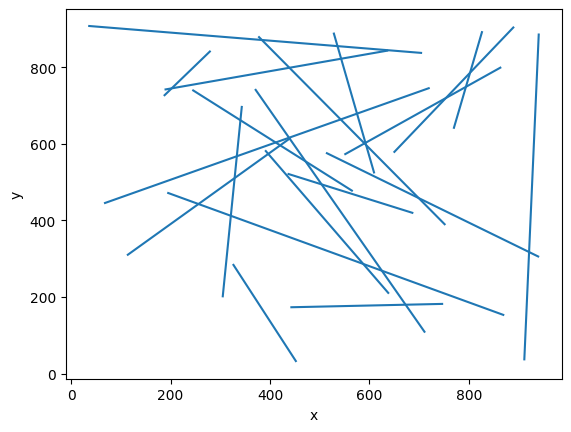

In [9]:
vis_sections(section)

Uzupełnij funkcję ```add_sections``` #interaktywne dodawanie odcinków przez rysowanie myszką (jak?) TODO

In [10]:
def add_sections():
    %matplotlib tk

    fig, ax = plt.subplots()
    ax.set_title("Wprowadź odcinki za pomocą myszy")
    ax.set_xlabel("Oś X")
    ax.set_ylabel("Oś Y")

    sections = []

    print("Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.")

    while True:

        points = plt.ginput(2, timeout=0, show_clicks=True)

        if len(points) == 0:
            break
        elif len(points) == 2:
            ax.plot([points[0][0], points[1][0]], [points[0][1], points[1][1]], 'ro-')
            if points[0][0] < points[1][0]:
                sections.append(((points[0][0], points[0][1]), (points[1][0], points[1][1])))
            elif points[0][0] > points[1][0]:
                sections.append(((points[1][0], points[1][1]), (points[0][0], points[0][1])))

    return sections




Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.
[((0.042338709677419345, 0.9556277056277057), (0.8810483870967741, 0.16558441558441558)), ((0.15478668054110298, 0.22765924551638833), (0.7648803329864723, 0.8554615027829314)), ((0.06550468262226847, 0.509817563388992), (0.2645291363163371, 0.5380333951762524)), ((0.5956165452653485, 0.7966785198928057), (0.6290972944849115, 0.24646980004122857)), ((0.6514177939646201, 0.8060837971552257), (0.6923387096774192, 0.27468563182848893))]


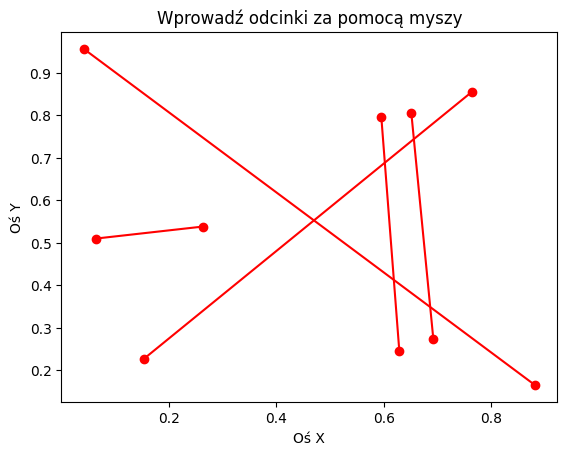

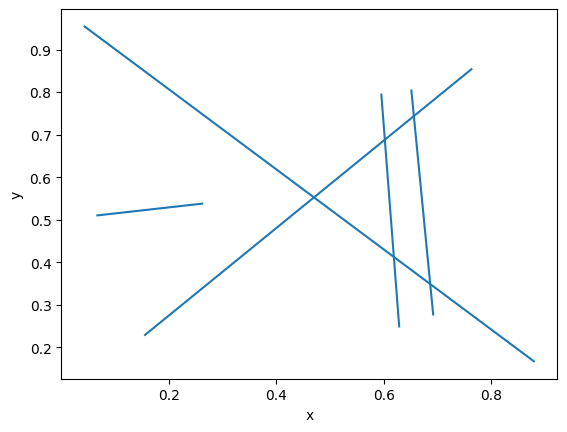

In [11]:
sections = add_sections()
%matplotlib inline
# plt.show()
print(sections)
vis_sections(sections)

In [12]:
class Point:
    def __init__(self, x, y, seg1, seg2=None, pos=None):
        self.x = x
        self.y = y
        self.seg1 = seg1
        self.seg2 = seg2
        self.pos = pos
       
    def __eq__(self, other):
        return self.x == other.x and self.y == other.y
    
    def __gt__(self, other):
        return self.x > other.x
    
    def __hash__(self):
        return hash((self.x, self.y))

In [13]:
class Segment:
    def __init__(self, l, r):
        self.l = l
        self.r = r
        self.a = (self.l.y - self.r.y) / (self.l.x - self.r.x)
        self.b = self.l.y - self.a * self.l.x
        self.x = self.l.x
        
    def move_right_to(x):
        Segment.x = x
        
    def __eq__(self, other):
        return self.l == other.l and self.r == other.r
    
    def __gt__(self, other):
        return self.a * Segment.x + self.b > other.a * Segment.x + other.b
    
    def __hash__(self):
        return hash((self.l, self.r))

In [14]:
def transform_segments_and_points_to_nodes(sections):
    node_points = []
    node_seg = []

    for i in range(len(sections)):
        if sections[i][0][0] == sections[i][1][0]:
            # print(1)
            continue
        if sections[i][0][0] > sections[i][1][0]:
            l = Point(sections[i][1][0], sections[i][1][1], i, i, pos="l")
            r = Point(sections[i][0][0], sections[i][0][1], i, i, pos="r")
        else:
            l = Point(sections[i][0][0], sections[i][0][1], i, i, pos="l")
            r = Point(sections[i][1][0], sections[i][1][1], i, i, pos="r")
            
        node_points.append(l)
        node_points.append(r)
        node_seg.append(Segment(l, r))

    return node_points, node_seg

In [46]:
def on_segment(p, q, r): 
    if ( (q[0] <= max(p[0], r[0])) and (q[0] >= min(p[0], r[0])) and 
           (q[1] <= max(p[1], r[1])) and (q[1] >= min(p[1], r[1]))): 
        return True
    return False
  

def det2x2(a, b):
    return a[0] * b[1] - a[1] * b[0]


def intersect(line1, line2):
    l1, r1 = line1.l, line1.r
    l2, r2 = line2.l, line2.r

    x1, y1 = l1.x, l1.y
    x2, y2 = r1.x, r1.y 
    x3, y3 = l2.x, l2.y
    x4, y4 = r2.x, r2.y


    main_d = det2x2([(x1-x2), (x3-x4)], [(y1-y2), (y3-y4)])

    t = det2x2([(x1-x3), (x3-x4)], [(y1-y3), (y3-y4)]) / main_d
    u = -det2x2([(x1-x2), (x1-x3)], [(y1-y2), (y1-y3)]) / main_d

    if 0 < t < 1 and 0 < u < 1:
        point = Point(x1 + t*(x2-x1), y1 + t*(y2-y1), line1.l.seg1, line2.l.seg1, pos="cross")
        return point
        
  

    return None

In [17]:
line1 = ((1, 1), (2, 2))
line2 = ((1, 2), (2, 1))

sections = [line1, line2]
points, segments = transform_segments_and_points_to_nodes(sections)
p = intersect(segments[0],  segments[1])
print(p.x, p.y)

1.5 1.5


Uzupełnij funkcję ```is_intersection```

In [18]:
def is_intersection(sections):
    """
    Funkcja sprawdza czy jakakolwiek para podanych odcinków się przecina 
    :param sections: tablica odcinków w postaci krotek krotek współrzędnych punktów końcowych odcinków
    :param eps: epsilon będący dokładnością, z jaką porównujemy liczby zmiennoprzecinkowe
    :return: True / False
    """

    points, sections = transform_segments_and_points_to_nodes(sections)

    Q = PriorityQueue()
    T = sc.SortedSet()

    for p in points:
        Q.put(p)


    start = Q.get()

    Segment.move_right_to(start.x)

    Q.put(start)


    while not Q.empty():
        curr_point = Q.get()

        if curr_point.pos == "l":

            Segment.move_right_to(curr_point.x)

            temp = sections[curr_point.seg1]


            T.add(temp)

            i = T.index(temp)
            if i-1 >= 0:
                if intersect(T[i-1], T[i]):
                    return True
                    
            if i+1 < len(T):
                if intersect(T[i+1], T[i]):
                    return True
                
        elif curr_point.pos == "r":
            seg1 = sections[curr_point.seg1]
            i = T.index(seg1)
            if 0 <= i-1 and i+1 < len(T):
                if intersect(T[i-1], T[i+1]):
                    return True
    
            T.remove(seg1)

    return False

In [47]:
Test().runtest(2, is_intersection)

Lab 4, task 2:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.018s


### W jaki sposób zaimplementowałeś struktura stanu (stan miotły) oraz struktura zdarzeń w Twoim programie?

Odpowiedź here

Uzupełnij funkcję ```is_intersection_with_visualization```

In [21]:
def is_intersection_with_visualization(sections): 
    """
    Funkcja sprawdza czy jakakolwiek para podanych odcinków się przecina i dodatkowo zwraca kolejne kroki w wizualizacji 
    :param sections: tablica odcinków w postaci krotek ktorek współrzędnych punktów końcowych odcinków
    :return: True / False
    """
    vis = Visualizer()
    vis.add_line_segment(sections)

    

    max_val = -float('inf')
    min_val = float('inf')

    points, sections = transform_segments_and_points_to_nodes(sections)

    to_r_points = []
    to_r_in_T = []

    Q = PriorityQueue()
    T = sc.SortedSet()

    for p in points:
        Q.put(p)
        max_val = max(max_val, p.y)
        min_val = min(min_val, p.y)


    start = Q.get()
    t = vis.add_point((start.x, start.y), color="red")
    to_r_points.append(t)

    Segment.move_right_to(start.x)
    to_r_vert = []
    t = vis.add_line_segment(((start.x, min_val), (start.x, max_val)), color="green")
    to_r_vert.append(t)

    Q.put(start)

    last = start.x

    while not Q.empty():
        curr_point = Q.get()
        if last != curr_point.x:
            last = curr_point.x
            vis.remove_figure(to_r_vert.pop())
            t = vis.add_line_segment(((curr_point.x, min_val), (curr_point.x, max_val)), color="green")
            to_r_vert.append(t)

        if curr_point.pos == "l":

            Segment.move_right_to(curr_point.x)
            

            t = vis.add_point((curr_point.x, curr_point.y), color="red")
            to_r_points.append(t)

            temp = sections[curr_point.seg1]


            T.add(temp)

            i = T.index(temp)
            if i-1 >= 0:
                p = intersect(T[i-1], T[i])

                t = vis.add_line_segment(((T[i-1].l.x, T[i-1].l.y), (T[i-1].r.x, T[i-1].r.y)), color="yellow")
                to_r_in_T.append(t)
                t = vis.add_line_segment(((T[i].l.x, T[i].l.y), (T[i].r.x, T[i].r.y)), color="yellow")
                to_r_in_T.append(t)

                if p:
                    vis.add_point((p.x, p.y), color="green")
                    return True, vis
                
                vis.remove_figure(to_r_in_T.pop())
                vis.remove_figure(to_r_in_T.pop())
                    
            if i+1 < len(T):
                p = intersect(T[i+1], T[i])

                t = vis.add_line_segment(((T[i+1].l.x, T[i+1].l.y), (T[i+1].r.x, T[i+1].r.y)), color="yellow")
                to_r_in_T.append(t)
                t = vis.add_line_segment(((T[i].l.x, T[i].l.y), (T[i].r.x, T[i].r.y)), color="yellow")
                to_r_in_T.append(t)

                if p:
                    vis.add_point((p.x, p.y), color="green")
                    return True, vis
                
                vis.remove_figure(to_r_in_T.pop())
                vis.remove_figure(to_r_in_T.pop())
                
        elif curr_point.pos == "r":
            t = vis.add_point((curr_point.x, curr_point.y), color="red")
            to_r_points.append(t)

            seg1 = sections[curr_point.seg1]
            i = T.index(seg1)
            if 0 <= i-1 and i+1 < len(T):
                p = intersect(T[i+1], T[i-1])

                t = vis.add_line_segment(((T[i+1].l.x, T[i+1].l.y), (T[i+1].r.x, T[i+1].r.y)), color="yellow")
                to_r_in_T.append(t)
                t = vis.add_line_segment(((T[i-1].l.x, T[i-1].l.y), (T[i-1].r.x, T[i-1].r.y)), color="yellow")
                to_r_in_T.append(t)

                if p:
                    vis.add_point((p.x, p.y), color="green")
                    return True, vis
                
                vis.remove_figure(to_r_in_T.pop())
                vis.remove_figure(to_r_in_T.pop())
    
            T.remove(seg1)
            vis.remove_figure(to_r_in_T.pop())

    return False, vis


Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.
[((0.10685483870967741, 0.7797619047619049), (0.6431451612903226, 0.06818181818181818)), ((0.28698783818938606, 0.7488420557616988), (0.5771901014568159, 0.3655206400742116)), ((0.12999317117585846, 0.4227011827458257), (0.3405087473985432, 0.5370622680890539)), ((0.2774730098855359, 0.6577767470624615), (0.4927460002601457, 0.7318996727478871)), ((0.2905558988033299, 0.2596307462378892), (0.4796631113423518, 0.38246302308802316)), ((0.43208896982310097, 0.4756461296639869), (0.5974091116024974, 0.613302991651206)), ((0.3833254747658689, 0.11562049062049062), (0.5807581620707597, 0.2278637780869924)), ((0.10263803980228926, 0.27233753349824785), (0.29293460587929243, 0.39516981034838183)), ((0.18589357222504277, 0.11773828849721707), (0.2781938810759227, 0.18127222479901053)), ((0.13315053859596854, 0.6408343640486499), (0.18709227753479446, 0.5307088744588746))]


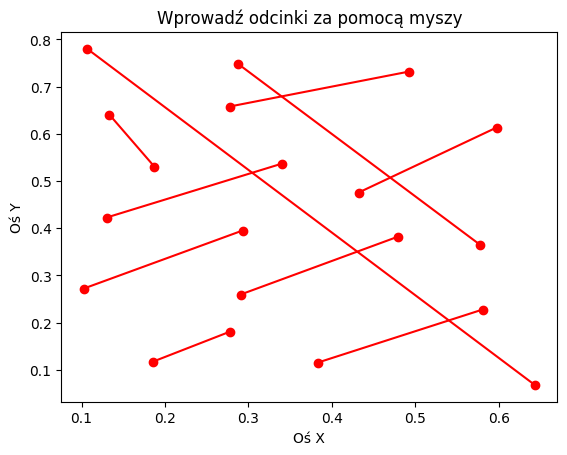

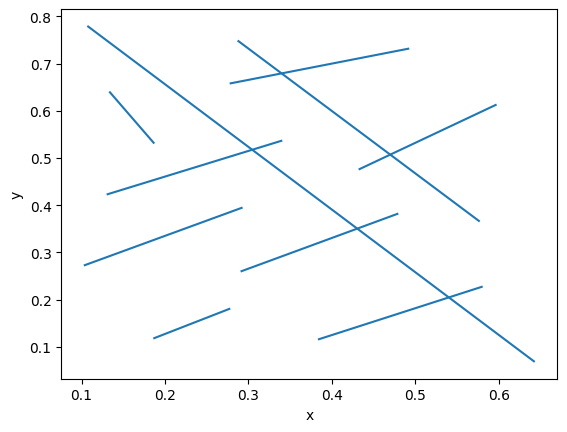

In [22]:
sec_vis1 = add_sections()
%matplotlib inline
# plt.show()
print(sec_vis1)
vis_sections(sec_vis1)

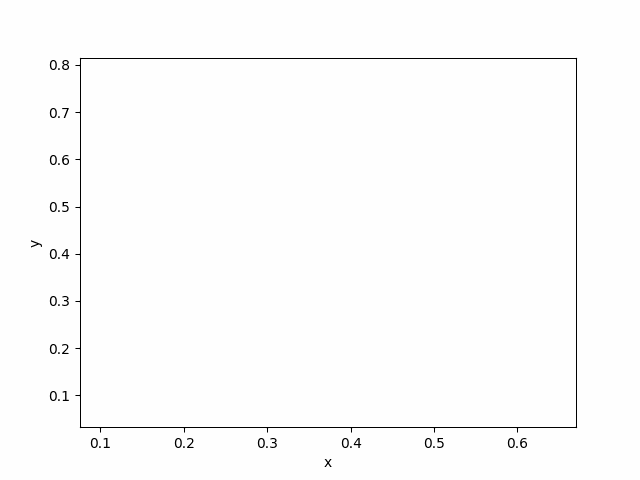

In [23]:
_, vis = is_intersection_with_visualization(sec_vis1)
vis.show_gif()

Uzupełnij funkcję ```find_intersections```

In [24]:
def find_intersections(sections):
    """
    Funkcja znajduje wszystkie przecięcia zadanych odcinków
    :param sections: tablica odcinków w postaci krotek ktorek współrzędnych punktów końcowych odcinków
    :return: tablica punktów przecięć w postaci trzyelementowych krotek w których pierwszym elementem są współrzędne danego punktu, a drugim i trzecim indeksy prostych z listy wejściowej, które się przecinają w tym punkcie współrzędnych np.:
    [((x1, y1), id1,id2),
    ((x2, y2), id3, id4),
    ...]
    """

    def intersect_operations(s1, s2):
        intersect_point = intersect(s1, s2)
        if intersect_point is not None and not is_in_res(s1, s2):
            Q.put(intersect_point)
            res.append(((intersect_point.x,intersect_point.y), intersect_point.seg1+1, intersect_point.seg2+1))

    vis =Visualizer()
    vis_sections(sections)

    points, sections = transform_segments_and_points_to_nodes(sections)

    Q = PriorityQueue()
    T = sc.SortedSet()

    for p in points:
        Q.put(p)


    start = Q.get()

    Segment.move_right_to(start.x)

    Q.put(start)


    res = []


    def is_in_res(s1, s2):
        a = sections.index(s1)
        b = sections.index(s2)

        for _, seg1, seg2 in res:
            seg1 -= 1
            seg2 -= 1
            if (seg1 == a and seg2 == b) or (seg1 == b and seg2 == a):
                return True
            
        return False

    while not Q.empty():
        curr_point = Q.get()
        # print(T)

        

        if curr_point.pos == "l":

            Segment.move_right_to(curr_point.x)

            # print(T)

            temp = sections[curr_point.seg1]
            # print(temp)
            

            T.add(temp)
            # print(T)
            # print(temp)
            # i = T.index(temp)
            # print(T)
            # print(temp)

            i = T.index(temp)
            if i-1 >= 0:
                intersect_operations(T[i-1], T[i])
                    
            if i+1 < len(T):
                intersect_operations(T[i+1], T[i])
                
        elif curr_point.pos == "r":
            seg1 = sections[curr_point.seg1]
            i = T.index(seg1)
            if 0 <= i-1 and i+1 < len(T):
                intersect_operations(T[i+1], T[i-1])
    
            
            T.remove(seg1)

        elif curr_point.pos == "cross":  
            seg1 = sections[curr_point.seg1]
            seg2 = sections[curr_point.seg2]
            
            T.remove(seg1)
            T.remove(seg2)
            
            Segment.move_right_to(curr_point.x+0.000000001)

            T.add(seg1)
            T.add(seg2)
            
            i = T.index(seg1)
            j = T.index(seg2)
            
            if i > j:
                i, j = j, i
            
            if i-1 >= 0:
                intersect_operations(T[i], T[i-1])
              
            if j+1 < len(T):
                intersect_operations(T[j], T[j+1])

    return res

    

[]


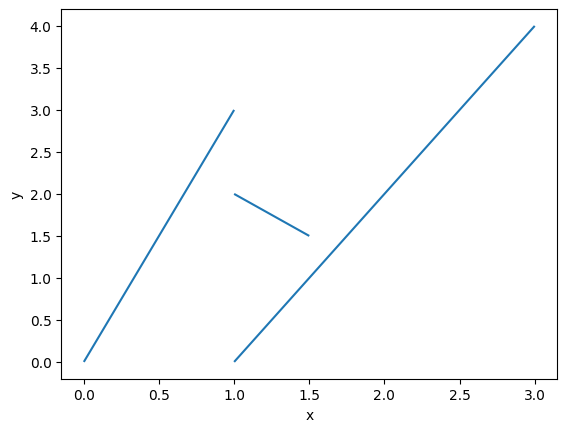

In [25]:
sections = [((1,0), (3,4)), ((1.5, 1.5),(1, 2)), ((0, 0), (1, 3))]
print(find_intersections(sections))

Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.


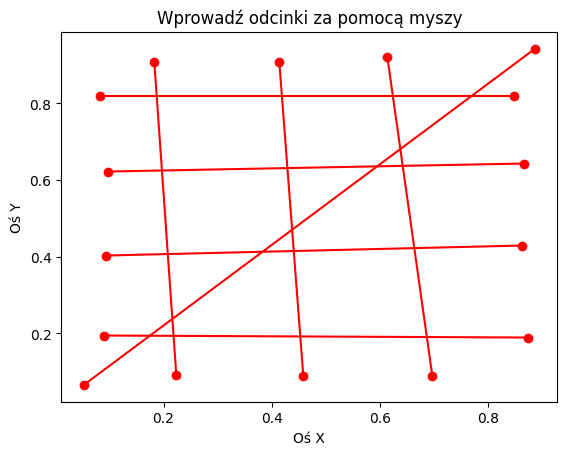

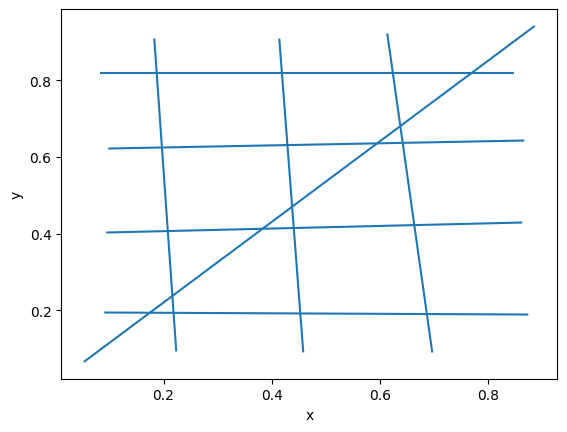

In [27]:
sec1 = add_sections()
%matplotlib inline
vis_sections(sec1)

[((0.7713349654377881, 0.820520253555968), 1, 2), ((0.1746030487723058, 0.1938001152172909), 1, 5), ((0.3831994150546191, 0.41287930284298413), 1, 4), ((0.18726141451513167, 0.8205202535559679), 2, 6), ((0.1970154535082412, 0.6249286347589383), 6, 3), ((0.2078864385384825, 0.4069395984750762), 6, 4), ((0.21633010169968336, 0.2376241233736558), 6, 1), ((0.2185301430200044, 0.19350807631192846), 6, 5), ((0.595383185980064, 0.6357261768810009), 1, 3), ((0.4190355906632555, 0.8205202535559679), 2, 7), ((0.42930104358318355, 0.6312246101573971), 7, 3), ((0.4380195700356556, 0.47045439503085984), 7, 1), ((0.44103558772806406, 0.4148388256020989), 7, 4), ((0.4531228745686549, 0.19194844197460614), 7, 5), ((0.6243277420700419, 0.8205202535559679), 2, 8), ((0.6383108146500641, 0.6808110946258908), 8, 1), ((0.6426948820755544, 0.637008534837775), 8, 3), ((0.6641745195732264, 0.4223989008142668), 8, 4), ((0.6873955040766113, 0.19039093576005606), 8, 5)]
19


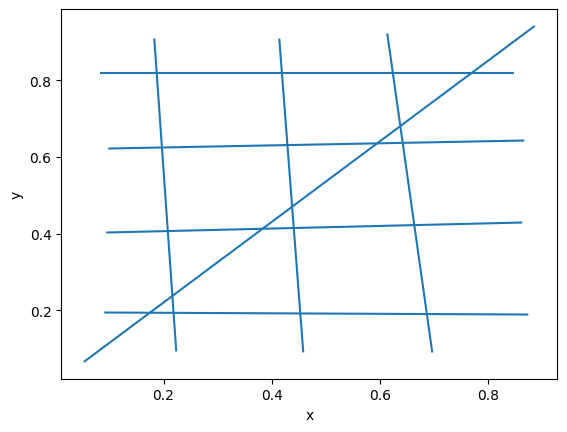

In [28]:
tab = find_intersections(sec1)
print(tab)
print(len(tab))

Lab 4, task 3:
	Test 1: WRONG ANSWER
		Output:   [((-0.0016743790516658141, -0.007263586832941069), 1, 2), ((0.01152607474025421, 0.006132801296422442), 2, 3), ((0.011860591253227503, -0.018140143229495413), 3, 1), ((0.0223444511307787, 0.017111754849194888), 2, 4), ((0.022658670631229855, -0.026817363547212175), 4, 1)]
		Expected: ['-0.0016743790516658117 -0.007263586832941072 1 2', '0.011526074740254208 0.006132801296422439 2 3', '0.011860591253227505 -0.018140143229495424 1 3', '0.022344451130778698 0.01711175484919488 2 4', '0.022658670631229855 -0.026817363547212168 1 4']
	Test 2: WRONG ANSWER
		Output:   [((0.005806934807635715, -0.01655644472067816), 2, 3), ((0.013332591183346308, -0.01619339562692305), 3, 4), ((0.010025601838031008, -0.020988202988542266), 2, 4)]
		Expected: ['0.005806934807635715 -0.016556444720678153 2 3', '0.010025601838031018 -0.020988202988542273 2 4', '0.013332591183346312 -0.01619339562692305 3 4']
	Test 3: Passed
Result: 1/3
Time: 0.045s


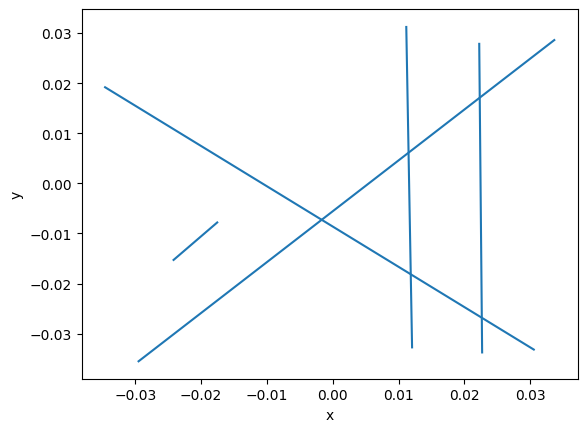

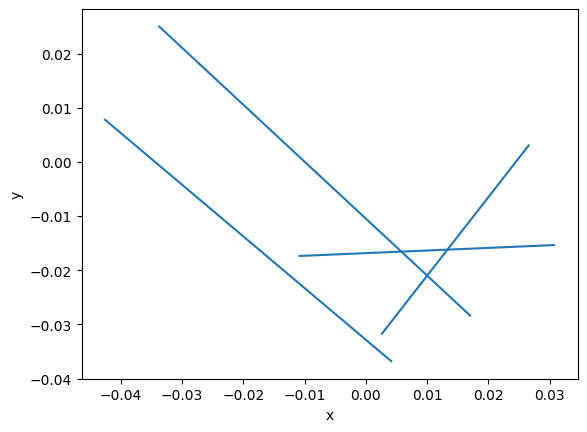

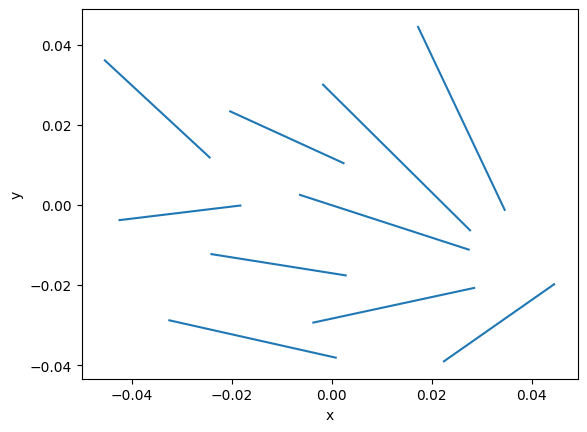

In [29]:
Test().runtest(3, find_intersections)

Uzupełnij funkcję ```find_intersections_with_visualization```

In [30]:
def find_intersections_with_visualization(sections):
    """
    Funkcja znajduje wszystkie przecięcia zadanych odcinków i dodatkowo zwraca kolejne kroki w wizualizacji 
    :param sections: tablica odcinków w postaci krotek ktorek współrzędnych punktów końcowych odcinków
    :return: tablica punktów przecięć w postaci trzyelementowych krotek w których pierwszym elementem są współrzędne danego punktu, a drugim i trzecim indeksy prostych z listy wejściowej, które się przecinają w tym punkcie współrzędnych np.:
    [((x1, y1), id1,id2),
    ((x2, y2), id3, id4),
    ...]
    """

    to_r_vert = []
    to_r_points = []
    to_r_in_T = []

    max_val = -float("inf")
    min_val = float("inf")

    def intersect_operations(s1, s2):
        intersect_point = intersect(s1, s2)

        t = vis.add_line_segment(((s1.l.x, s1.l.y), (s1.r.x, s1.r.y)), color="yellow")
        to_r_in_T.append(t)
        t = vis.add_line_segment(((s2.l.x, s2.l.y), (s2.r.x, s2.r.y)), color="yellow")
        to_r_in_T.append(t)

        if intersect_point is not None and not is_in_res(s1, s2):
            Q.put(intersect_point)
            res.append(((intersect_point.x,intersect_point.y), intersect_point.seg1+1, intersect_point.seg2+1))
            t = vis.add_point((intersect_point.x,intersect_point.y), color="green")
            to_r_points.append(t)

        vis.remove_figure(to_r_in_T.pop())
        vis.remove_figure(to_r_in_T.pop())

    vis =Visualizer()
    vis.add_line_segment(sections)


    points, sections = transform_segments_and_points_to_nodes(sections)

    Q = PriorityQueue()
    T = sc.SortedSet()

    for p in points:
        Q.put(p)
        max_val = max(max_val, p.y)
        min_val = min(min_val, p.y)


    start = Q.get()

    Segment.move_right_to(start.x)

    Q.put(start)

    t = vis.add_line_segment(((start.x, min_val), (start.x, max_val)), color="green")
    to_r_vert.append(t)


    res = []


    def is_in_res(s1, s2):
        a = sections.index(s1)
        b = sections.index(s2)

        for _, seg1, seg2 in res:
            seg1 -= 1
            seg2 -= 1
            if (seg1 == a and seg2 == b) or (seg1 == b and seg2 == a):
                return True
            
        return False
    
    last = start.x

    while not Q.empty():
        curr_point = Q.get()

        
        # print(T)
        if curr_point.x != last:
            last = curr_point.x
            vis.remove_figure(to_r_vert.pop())
            t = vis.add_line_segment(((curr_point.x, min_val), (curr_point.x, max_val)), color="green")
            to_r_vert.append(t)

        t = vis.add_point((curr_point.x, curr_point.y), color="red")
        to_r_points.append(t)

        for elem in res:
            if (curr_point.x, curr_point.y) == elem[0]:
                vis.remove_figure(to_r_points.pop())
                break


        if curr_point.pos == "l":


            Segment.move_right_to(curr_point.x)

            # print(T)

            temp = sections[curr_point.seg1]
            # print(temp)
            

            T.add(temp)
            # t = vis.add_line_segment(((temp.l.x, temp.l.y), (temp.r.x, temp.r.y)), color="yellow")
            # to_r_in_T.append(t)
            # print(T)
            # print(temp)
            # i = T.index(temp)
            # print(T)
            # print(temp)

            i = T.index(temp)
            if i-1 >= 0:
                intersect_operations(T[i-1], T[i])
                    
            if i+1 < len(T):
                intersect_operations(T[i+1], T[i])
                
        elif curr_point.pos == "r":

            seg1 = sections[curr_point.seg1]
            i = T.index(seg1)
            if 0 <= i-1 and i+1 < len(T):
                intersect_operations(T[i+1], T[i-1])
    
            
            T.remove(seg1)
            # vis.remove_figure(to_r_in_T.pop())

        elif curr_point.pos == "cross":  
            seg1 = sections[curr_point.seg1]
            seg2 = sections[curr_point.seg2]
            
            T.remove(seg1)
            T.remove(seg2)
            # vis.remove_figure(to_r_in_T.pop())
            # vis.remove_figure(to_r_in_T.pop())
            
            Segment.move_right_to(curr_point.x+10**(-9))

            T.add(seg1)
            T.add(seg2)

            # t = vis.add_line_segment(((seg1.l.x, seg1.l.y), (seg1.r.x, seg1.r.y)), color="yellow")
            # to_r_in_T.append(t)
            # t = vis.add_line_segment(((seg2.l.x, seg2.l.y), (seg2.r.x, seg2.r.y)), color="yellow")
            # to_r_in_T.append(t)
            
            i = T.index(seg1)
            j = T.index(seg2)
            
            if i > j:
                i, j = j, i
            
            if i-1 >= 0:
                intersect_operations(T[i], T[i-1])
              
            if j+1 < len(T):
                intersect_operations(T[j], T[j+1])
                
    vis.remove_figure(to_r_vert.pop())
    # for elem in to_r_in_T:
    #     vis.remove_figure(elem)
    return (res, vis)

In [40]:
import csv

def save_sections_to_csv(sections, csv_filename='sections.csv'):
    with open(csv_filename, 'w', newline='') as csvfile:
        csv_writer = csv.writer(csvfile)
        csv_writer.writerow(['X1', 'Y1', 'X2', 'Y2'])  # Header row
        for section in sections:
            csv_writer.writerow([section[0][0], section[0][1], section[1][0], section[1][1]])

    print(f'Sections saved to {csv_filename}')

Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.
[((0.05443548387096775, 0.9366883116883117), (0.9596774193548386, 0.06818181818181818)), ((0.11356822320499482, 0.13642161410018552), (0.8784611569979187, 0.9196283627087197)), ((0.06538599115504684, 0.472450912183055), (0.29023640738813733, 0.4853751159554731)), ((0.5010336726066598, 0.23981524427953), (0.6074361017169615, 0.772292439703154)), ((0.6054285087148803, 0.286342377860235), (0.7459600188605618, 0.8679315476190476))]


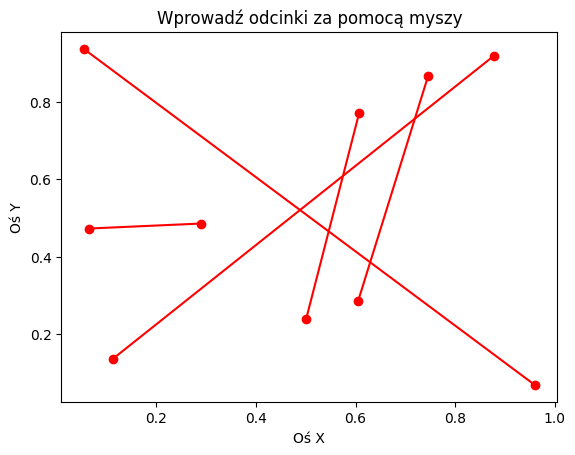

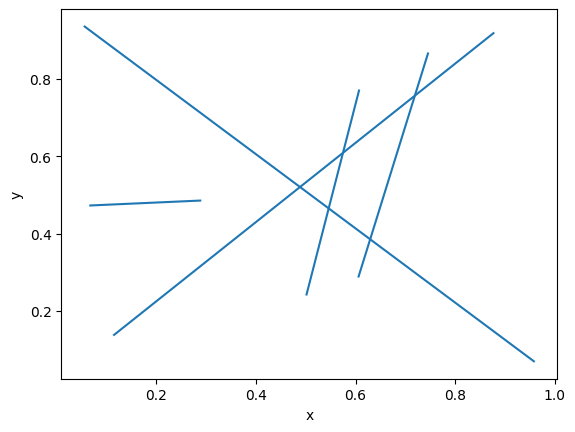

In [31]:
sec_vis2 = add_sections()
%matplotlib inline
# plt.show()
print(sec_vis2)
vis_sections(sec_vis2)

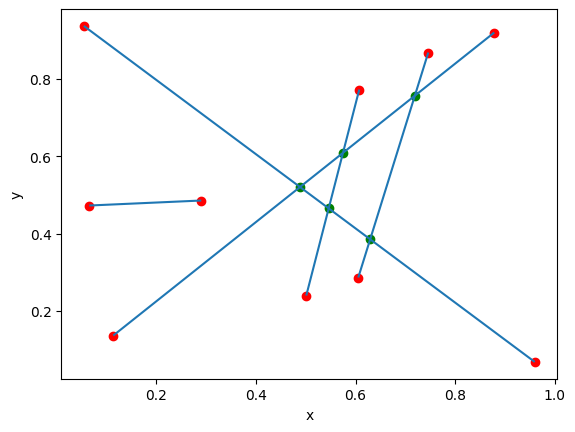

In [32]:
res, vis = find_intersections_with_visualization(sec_vis2)
vis.show()

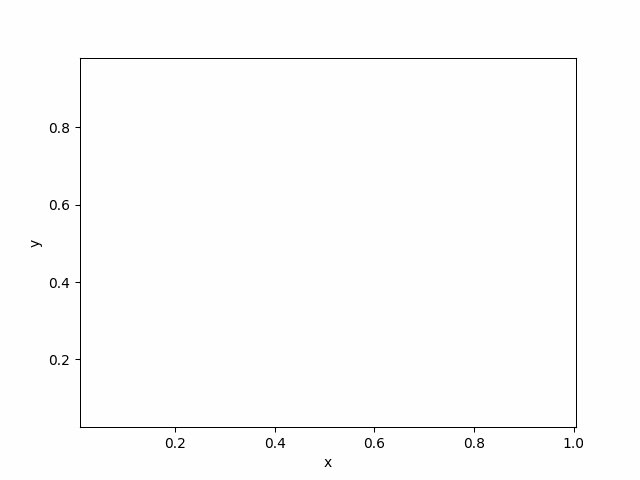

In [33]:
vis.show_gif()
# vis.save_gif()

In [41]:
save_sections_to_csv(sec_vis2)

Sections saved to sections.csv


Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.
[((0.04032258064516128, 0.027597402597402593), (0.9677419354838709, 0.9637445887445889)), ((0.04125747918834541, 0.8422683467326328), (0.9482960457856398, 0.8311237373737377)), ((0.05976847034339225, 0.6695269016697589), (0.9524095993756501, 0.6778853586889304)), ((0.05771169354838704, 0.5190746753246755), (0.9256715010405825, 0.5218608276643992)), ((0.05976847034339225, 0.33240246856318295), (0.9215579474505722, 0.33240246856318295)), ((0.04331425598335062, 0.17637793753865189), (0.9338986082206033, 0.1819502422180994)), ((0.11530144380853269, 0.9147083075654507), (0.20579962278876163, 0.06771799628942488)), ((0.2613325962539021, 0.9397836786229647), (0.37445531997918824, 0.06214569160997735)), ((0.4135340790842871, 0.9258529169243459), (0.5328271331945889, 0.07607645330859619)), ((0.5698491155046824, 0.9453559833024123), (0.6953124999999998, 0.06214569160997735)), ((0.7508454734651403, 0.9314252216037935), (0.85368

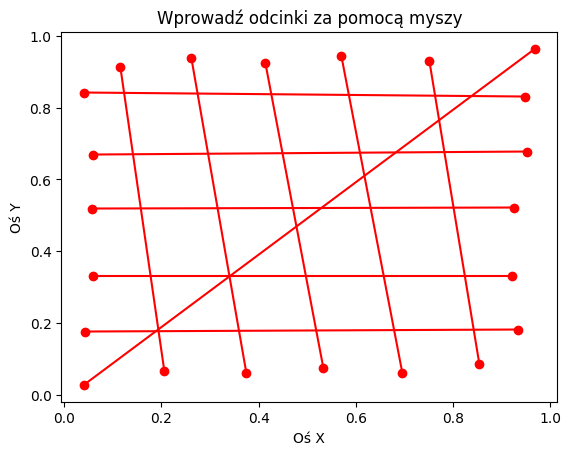

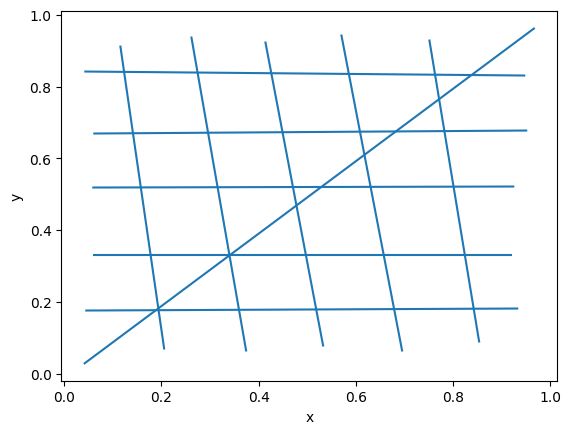

In [42]:
sec_vis3 = add_sections()
%matplotlib inline
# plt.show()
print(sec_vis3)
print(len(sec_vis3))
vis_sections(sec_vis3)

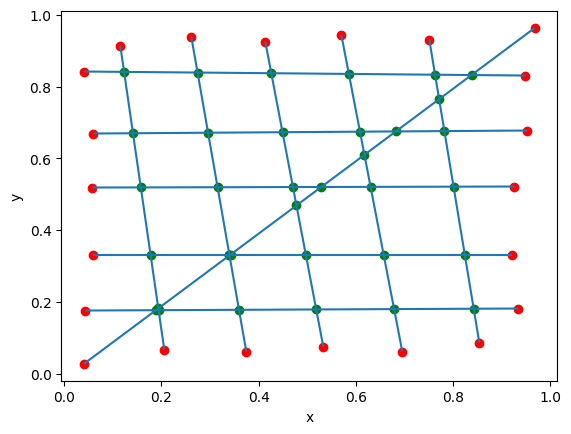

In [43]:
res, vis = find_intersections_with_visualization(sec_vis3)
vis.show()

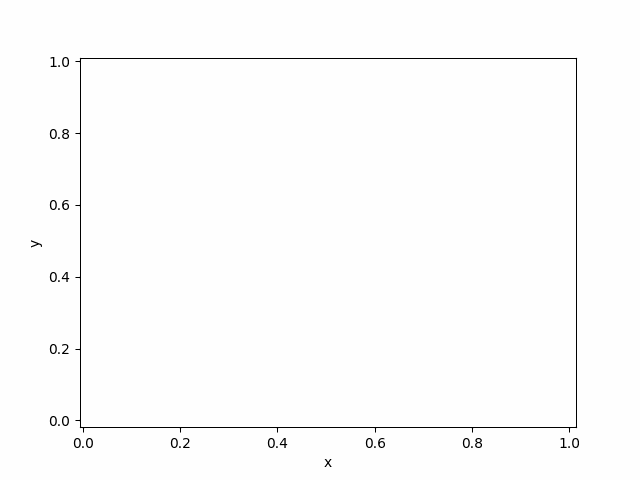

In [45]:
vis.show_gif()


In [ ]:
# vis.save_gif()

Kliknij dwukrotnie, aby dodać odcinek. Naciśnij enter, aby zakończyć.
[((0.1754032258064516, 0.9745670995670997), (0.9697580645161291, 0.1168831168831169)), ((0.14801720213319455, 0.7688250489589777), (0.7434630267950053, 0.12300943104514536)), ((0.5424859507891959, 0.48037775716347164), (0.9889761975879879, 0.4752724953617813)), ((0.6785334716448979, 0.2557462378890951), (1.014238877088545, 0.8249829287775718))]
4


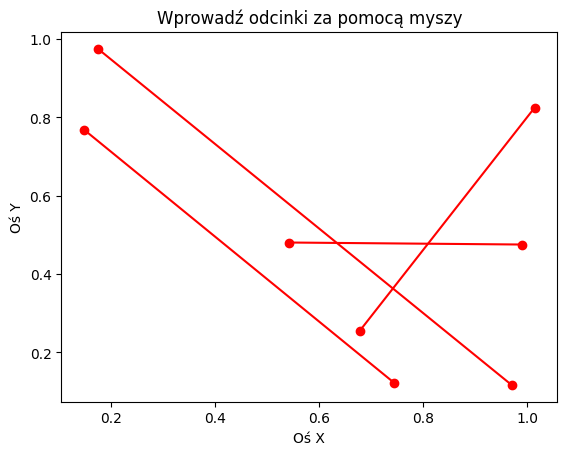

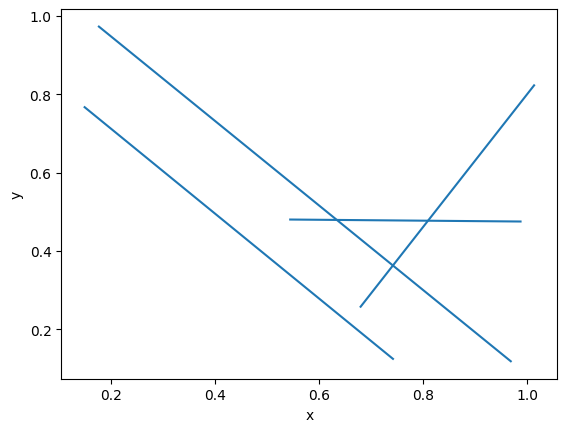

In [49]:
sec_vis4 = add_sections()
%matplotlib inline
# plt.show()
print(sec_vis4)
print(len(sec_vis4))
vis_sections(sec_vis4)

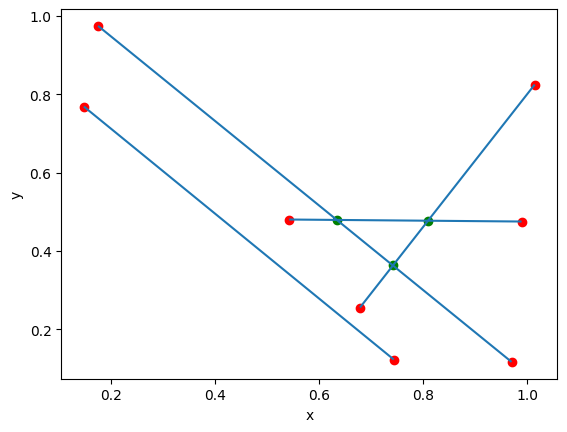

In [50]:
res, vis = find_intersections_with_visualization(sec_vis4)
vis.show()

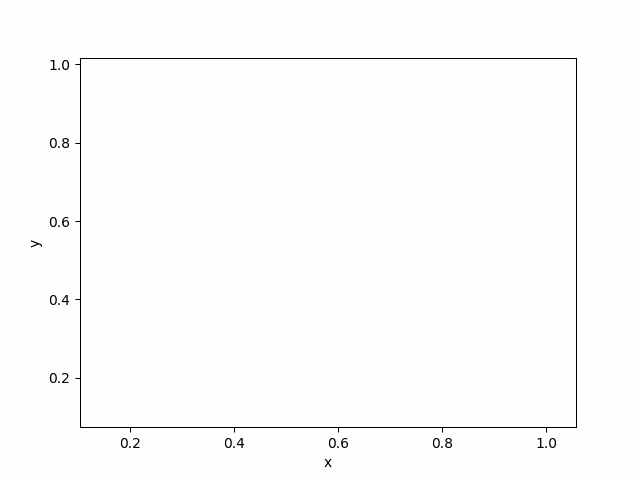

In [51]:
vis.show_gif()

In [ ]:
vis.save_gif()

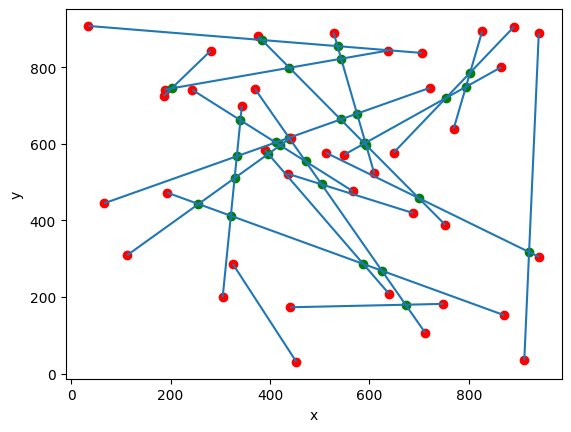

In [52]:
res, vis = find_intersections_with_visualization(section)
vis.show()

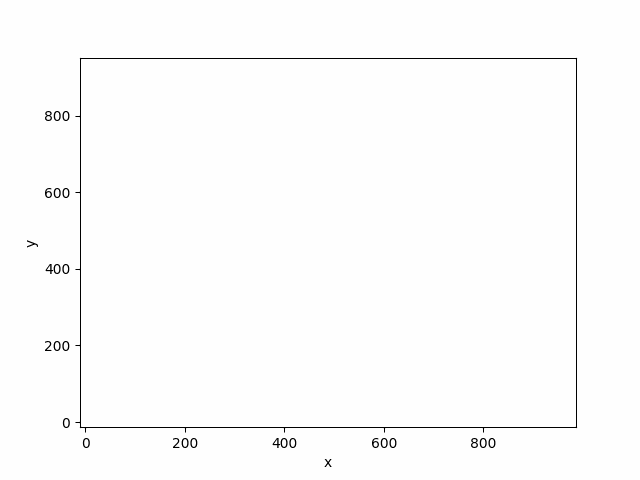

In [53]:
vis.show_gif()

### Czy konieczne były zmiany w strukturze zdarzeń. Jeśli tak, to jakie? Czy w przypadku obu algorytmów konieczne są takie same struktury zdarzeń?
### Odpowiedź uzasadnij. 

Użyłem tych samych struktur danych, jednak w przypadku sprawdzania czy istnieje przecięcie nie jest to konieczne, lecz inne propozycje dają gorszą złożoność obliczeniową. Użyte struktury to SortedSet oraz PriorityQueue

### Jak obsługiwane są zdarzenia początku odcinka, końca odcinka i przecięcia odcinków z uwzględnianiem wybranych struktur danych?

Odpowiedź here

### Samemu zaprojektuj test, który uwzględnia taki układ odcinków, przy którym pewne przecięcia będą wykrywane więcej niż jeden raz

Odpowiedź here

### Zadanie dodatkowe
Zaimplementuj inną strukturę stanu. Opisz ją w sprawozdaniu. Porównaj efektywność algorytmu dla obu struktur robiąc testy na odpowiednio dużych zestawach odcinków.